In [91]:
# Importando bibliotecas necessárias

# Bibliotecas para manipulação de dados
import pandas as pd

# Bibliotecas para manipulação de texto e NLP
import re
import nltk
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
from nltk.tokenize import word_tokenize

# Bibliotecas para machine learning
from sklearn.datasets import fetch_20newsgroups
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import (
	accuracy_score,
	classification_report,
	confusion_matrix,
)

# Bibliotecas para visualização
import matplotlib.pyplot as plt
import seaborn as sns

In [92]:
# --- Bloco de configuração inicial do NLTK (executar apenas uma vez) ---
# É necessário baixar esses pacotes para que o NLTK funcione corretamente.
stopwords.words("english")
print("Baixando pacotes do NLTK...")
nltk.download("punkt")
nltk.download("stopwords")
nltk.download("wordnet")
nltk.download("omw-1.4")
# -------------------------------------------------------------------------

Baixando pacotes do NLTK...


[nltk_data] Downloading package punkt to /Users/lucas/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to /Users/lucas/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to /Users/lucas/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to /Users/lucas/nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


True

## Definição

O `fetch_20newsgroups` é uma função da biblioteca scikit-learn que carrega um dataset composto por aproximadamente 18.000 documentos de texto. A principal característica deste conjunto de dados é que cada documento está organizado em uma de 20 categorias (ou "newsgroups") distintas.

## O que eram os "Newsgroups"?

Eles eram fóruns de discussão online, muito populares nos primórdios da internet (anos 80 e 90), um precursor de plataformas como Reddit ou fóruns de sites. Cada grupo era dedicado a um tópico específico, e as pessoas postavam mensagens (textos) para discutir aquele assunto.

O dataset fetch_20newsgroups é, portanto, uma coleção de postagens retiradas de 20 desses fóruns. A seguir estão as categorias incluídas no dataset:

| Domínio | Exemplos de Categorias |
| :--- | :--- |
| **Computação** | `comp.graphics`, `comp.sys.ibm.pc.hardware` |
| **Ciência** | `sci.crypt`, `sci.electronics`, `sci.med`, `sci.space` |
| **Política** | `talk.politics.guns`, `talk.politics.mideast` |
| **Religião** | `soc.religion.christian`, `alt.atheism` |
| **Esportes** | `rec.sport.baseball`, `rec.sport.hockey` |
| **Outros** | `misc.forsale` (vendas), `rec.autos` (carros) |

## Estrutura do Dataset

O dataset carregado possui **18.846 documentos** distribuídos entre as 20 categorias. Cada entrada contém:

- **text**: O conteúdo completo da mensagem postada no newsgroup
- **target**: Um código numérico (0-19) que identifica a categoria
- **target_names**: O nome textual da categoria correspondente
- **filenames**: O caminho do arquivo de texto original
- **DESCR**: Uma descrição do dataset, incluindo informações sobre o número de documentos e categorias

Este dataset é amplamente utilizado para tarefas de **classificação de texto** e **processamento de linguagem natural**, sendo um benchmark clássico para algoritmos de machine learning aplicados a dados textuais.

In [93]:
# Carregando Datasets
newsgroups = fetch_20newsgroups(subset="all")
print(f"📊 Chaves disponíveis no dataset 20 Newsgroups: {newsgroups.keys()}")

📊 Chaves disponíveis no dataset 20 Newsgroups: dict_keys(['data', 'filenames', 'target_names', 'target', 'DESCR'])


In [94]:
# Montando o dataset

df = pd.DataFrame(
    data={
        "text": newsgroups["data"],
        "target": newsgroups["target"],
    }
)

df

,text,target
0,From: Mamatha Devineni Ratnam <mr47+@andrew.cm...,10
1,From: mblawson@midway.ecn.uoknor.edu (Matthew ...,3
2,From: hilmi-er@dsv.su.se (Hilmi Eren)\nSubject...,17
3,From: guyd@austin.ibm.com (Guy Dawson)\nSubjec...,3
4,From: Alexander Samuel McDiarmid <am2o+@andrew...,4
...,...,...
18841,From: jim.zisfein@factory.com (Jim Zisfein) \n...,13
18842,From: rdell@cbnewsf.cb.att.com (richard.b.dell...,12
18843,From: westes@netcom.com (Will Estes)\nSubject:...,3
18844,From: steve@hcrlgw (Steven Collins)\nSubject: ...,1


In [95]:
# Apresentando o mapping entre target e target_names
mapping = dict(
    zip(range(len(newsgroups["target_names"])), newsgroups["target_names"])
)
mapping

{0: 'alt.atheism',
 1: 'comp.graphics',
 2: 'comp.os.ms-windows.misc',
 3: 'comp.sys.ibm.pc.hardware',
 4: 'comp.sys.mac.hardware',
 5: 'comp.windows.x',
 6: 'misc.forsale',
 7: 'rec.autos',
 8: 'rec.motorcycles',
 9: 'rec.sport.baseball',
 10: 'rec.sport.hockey',
 11: 'sci.crypt',
 12: 'sci.electronics',
 13: 'sci.med',
 14: 'sci.space',
 15: 'soc.religion.christian',
 16: 'talk.politics.guns',
 17: 'talk.politics.mideast',
 18: 'talk.politics.misc',
 19: 'talk.religion.misc'}

In [96]:
def preprocessar_texto(texto: str) -> list[str]:
    """
    Função completa para limpar e pré-processar um único documento de texto.
    Aplica todos os passos da proposta: remoção de metadados, lowering,
    remoção de pontuação/números, tokenização, remoção de stopwords e lematização.

    :param texto: Uma string contendo o texto bruto do documento.
    :return: Uma lista de tokens (palavras) limpos.
    """

    # 1. Remoção de Metadados (Cabeçalhos, Assinaturas e Citações)
    # Remove cabeçalhos (tudo antes do primeiro par de quebras de linha)
    texto = re.sub(r"^.*?\n\n", "", texto, flags=re.DOTALL)
    # Remove assinaturas (começando com '-- ')
    texto = re.sub(r"--.*", "", texto, flags=re.DOTALL)
    # Remove linhas de citação (começando com '>')
    texto = re.sub(r">.*", "", texto)
    # Remove emails
    texto = re.sub(r"\S*@\S*\s?", "", texto)
    # Remove quebras de linha e tabs
    texto = re.sub(r"\s+", " ", texto).strip()

    # 2. Conversão para Minúsculas (Lowercasing)
    texto = texto.lower()

    # 3. Remoção de Pontuação e Números
    # Mantém apenas letras e espaços
    texto = re.sub(r"[^a-z\s]", "", texto)

    # 4. Tokenização
    tokens = texto.split()

    # 5. Remoção de Stopwords e 6. Lematização
    stop_words = set(stopwords.words("english"))
    lemmatizer = WordNetLemmatizer()

    tokens_limpos = [
        lemmatizer.lemmatize(token)
        for token in tokens
        if token not in stop_words
        and len(token) > 2  # Remove stopwords e tokens muito curtos
    ]

    tokens_para_vetorizar = " ".join(tokens_limpos)

    return tokens_para_vetorizar

In [97]:
# Preprocessamento dos dados
df["text"] = df["text"].apply(preprocessar_texto)

In [98]:
# Vetorizando os dados com TF-IDF
vectorizer = TfidfVectorizer()

X = vectorizer.fit_transform(df["text"])
y = df["target"]

In [99]:
# Exibindo o resultado da vetorização
print(f"📊 Forma da matriz TF-IDF: {X.shape}")
matriz_vetorizacao = X.toarray()
print("Amostra da matriz TF-IDF (primeiras 5 linhas, 10 colunas):")
print(matriz_vetorizacao[:2, :1000])

📊 Forma da matriz TF-IDF: (18846, 69860)
Amostra da matriz TF-IDF (primeiras 5 linhas, 10 colunas):
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


In [100]:
# Para matrizes muito grandes, ver apenas valores não-zero
import numpy as np
from regex import B

# Obtendo os nomes das features (palavras)
feature_names = vectorizer.get_feature_names_out()

# Encontrar coordenadas dos valores não-zero
coords = np.nonzero(matriz_vetorizacao)
for i, j in zip(coords[0], coords[1]):
    print(
        f"Doc {i}, Palavra '{feature_names[j]}': {matriz_vetorizacao[i,j]:.4f}"
    )

Doc 0, Palavra 'actually': 0.0659
Doc 0, Palavra 'also': 0.0482
Doc 0, Palavra 'anyway': 0.0768
Doc 0, Palavra 'bashers': 0.1514
Doc 0, Palavra 'beat': 0.0967
Doc 0, Palavra 'better': 0.0621
Doc 0, Palavra 'bit': 0.1964
Doc 0, Palavra 'bowman': 0.1400
Doc 0, Palavra 'confused': 0.1044
Doc 0, Palavra 'couple': 0.0772
Doc 0, Palavra 'devil': 0.2049
Doc 0, Palavra 'disappointed': 0.1257
Doc 0, Palavra 'end': 0.0701
Doc 0, Palavra 'fan': 0.0845
Doc 0, Palavra 'final': 0.0891
Doc 0, Palavra 'fun': 0.1851
Doc 0, Palavra 'game': 0.1336
Doc 0, Palavra 'going': 0.1239
Doc 0, Palavra 'however': 0.0637
Doc 0, Palavra 'islander': 0.1140
Doc 0, Palavra 'jagr': 0.2627
Doc 0, Palavra 'jersey': 0.1124
Doc 0, Palavra 'killing': 0.0918
Doc 0, Palavra 'kind': 0.0703
Doc 0, Palavra 'lack': 0.0904
Doc 0, Palavra 'let': 0.0631
Doc 0, Palavra 'lose': 0.0957
Doc 0, Palavra 'lot': 0.1247
Doc 0, Palavra 'man': 0.0767
Doc 0, Palavra 'massacre': 0.1033
Doc 0, Palavra 'much': 0.0534
Doc 0, Palavra 'next': 0.0717
D

Uma ótima técnica (que não abordaremos aqui) é reduzir a esparsidade da MAtriz gerada por este dataset, utilizando técnicas como TF-IDF (Term Frequency-Inverse Document Frequency) ou Word Embeddings (como Word2Vec ou GloVe). Isso ajuda a melhorar a performance de modelos de classificação.


Para deixar a matriz TF-IDF menos esparsa, você pode usar várias estratégias:

1. Reduzir o número de features (mais efetivo)
```python
# Limitar o vocabulário
vectorizer = TfidfVectorizer(
    max_features=1000,  # Apenas as 1000 palavras mais importantes
    min_df=2,          # Palavra deve aparecer em pelo menos 2 documentos
    max_df=0.8         # Palavra não pode aparecer em mais de 80% dos docs
)
X = vectorizer.fit_transform(df['text'])
```
2. Usar n-gramas menores
```python
vectorizer = TfidfVectorizer(
	ngram_range=(1, 1),  # Apenas unigramas (palavras únicas)
	max_features=1000,
	min_df=2
)
```
3. Aumentar min_df (frequência mínima)
```python
vectorizer = TfidfVectorizer(
    min_df=5,          # Palavra deve aparecer em pelo menos 5 documentos
    max_features=1000
)
```
4. Usar dimensionalidade reduzida com PCA ou SVD
```python
from sklearn.decomposition import TruncatedSVD
from sklearn.pipeline import Pipeline

# Pipeline com TF-IDF + SVD
pipeline = Pipeline([
    ('tfidf', TfidfVectorizer(max_features=5000)),
    ('svd', TruncatedSVD(n_components=100))  # Reduzir para 100 dimensões
])

X_reduced = pipeline.fit_transform(df['text'])
print("Shape original vs reduzida:", X.shape, "->", X_reduced.shape)
```
5. Filtrar stopwords mais agressivamente
```python
from sklearn.feature_extraction.text import ENGLISH_STOP_WORDS

# Adicionar mais stopwords customizadas
custom_stopwords = list(ENGLISH_STOP_WORDS) + ['said', 'like', 'said', 'get', 'go']

vectorizer = TfidfVectorizer(
    stop_words=custom_stopwords,
    max_features=1000,
    min_df=3
)
```
6. Exemplo completo otimizado
```python
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.decomposition import TruncatedSVD
import pandas as pd

# Configuração para matriz menos esparsa
vectorizer = TfidfVectorizer(
    max_features=1000,    # Limitar vocabulário
    min_df=2,            # Frequência mínima
    max_df=0.9,          # Frequência máxima
    ngram_range=(1, 1),  # Apenas unigramas
    stop_words='english'
)

# Vetorização
X = vectorizer.fit_transform(df['text'])

# Verificar esparsidade
sparsity = 1.0 - (X.nnz / (X.shape[0] * X.shape[1]))
print(f"Esparsidade: {sparsity:.4f} ({sparsity*100:.2f}%)")

# Opcional: Reduzir ainda mais com SVD
svd = TruncatedSVD(n_components=100)
X_dense = svd.fit_transform(X)

print(f"Shape original: {X.shape}")
print(f"Shape reduzida: {X_dense.shape}")
print(f"Variância explicada: {svd.explained_variance_ratio_.sum():.4f}")
```
7. Verificar o resultado
```python
# Comparar esparsidade antes e depois
def calcular_esparsidade(matriz):
    if hasattr(matriz, 'nnz'):  # Matriz esparsa
        return 1.0 - (matriz.nnz / (matriz.shape[0] * matriz.shape[1]))
    else:  # Matriz densa
        zeros = (matriz == 0).sum()
        total = matriz.size
        return zeros / total

print(f"Esparsidade original: {calcular_esparsidade(X):.4f}")
print(f"Esparsidade reduzida: {calcular_esparsidade(X_dense):.4f}")
```

Dica: Comece com max_features=1000 e min_df=2. Isso geralmente reduz significativamente a esparsidade mantendo informação relevante.		

In [101]:
# Vetorizando os dados com TF-IDF utilizando a técnica 1 de redução de dimensionalidade para reduzir tempo de treinamento
vectorizer = TfidfVectorizer(
    max_features=1000,  # Apenas as 1000 palavras mais importantes
    min_df=2,  # Palavra deve aparecer em pelo menos 2 documentos
    max_df=0.8,  # Palavra não pode aparecer em mais de 80% dos docs
)
X = vectorizer.fit_transform(df["text"])

y = df["target"]

In [102]:
# Apresentando o shape da matriz TF-IDF reduzida
print(f"📊 Forma da matriz TF-IDF reduzida: {X.shape}")

📊 Forma da matriz TF-IDF reduzida: (18846, 1000)


A partir deste ponto, você pode continuar com a análise de dados, treinamento de modelos de machine learning ou outras tarefas relacionadas ao processamento deste dataset. O `fetch_20newsgroups` é uma base excelente para explorar técnicas de NLP e classificação de texto.

Recomendamos que retorne ao notebook `Diabetes_Classification.ipynb` e aplique as técnicas de rexperimentação e construção de modelo trabalhadas lá. Isso contribuirá para melhorar a performance dos modelos que serão treinados com este dataset.

Somente para fins didáticos, a seguir apresentamos uma breve separação dos dados em treino e teste, além de um exemplo de aplicação de um modelo de classificação simples, como a regressão logística. Vale destacar que o exemplo abaixo é apenas ilustrativo e não cobre todos os requisitos necessários para a elaboração do modelo de classificação solicitado em aula.

In [103]:


X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42
)


# Instanciando o modelo de classificação com RL


model = LogisticRegression()
# Treinando o modelo
model.fit(X_train, y_train)
# Avaliando o modelo


y_pred = model.predict(X_test)
print(f"📊 Acurácia do modelo: {accuracy_score(y_test, y_pred):.4f}")
print("📊 Relatório de Classificação:")
print(
    classification_report(
        y_test, y_pred, target_names=newsgroups["target_names"]
    )
)

📊 Acurácia do modelo: 0.5324
📊 Relatório de Classificação:
                          precision    recall  f1-score   support

             alt.atheism       0.42      0.47      0.44       151
           comp.graphics       0.47      0.48      0.47       202
 comp.os.ms-windows.misc       0.54      0.45      0.49       195
comp.sys.ibm.pc.hardware       0.46      0.48      0.47       183
   comp.sys.mac.hardware       0.60      0.51      0.55       205
          comp.windows.x       0.63      0.55      0.59       215
            misc.forsale       0.73      0.65      0.69       193
               rec.autos       0.59      0.53      0.56       196
         rec.motorcycles       0.38      0.48      0.43       168
      rec.sport.baseball       0.59      0.62      0.60       211
        rec.sport.hockey       0.74      0.64      0.68       198
               sci.crypt       0.69      0.55      0.61       201
         sci.electronics       0.46      0.46      0.46       202
                

📊 Matriz de Confusão:


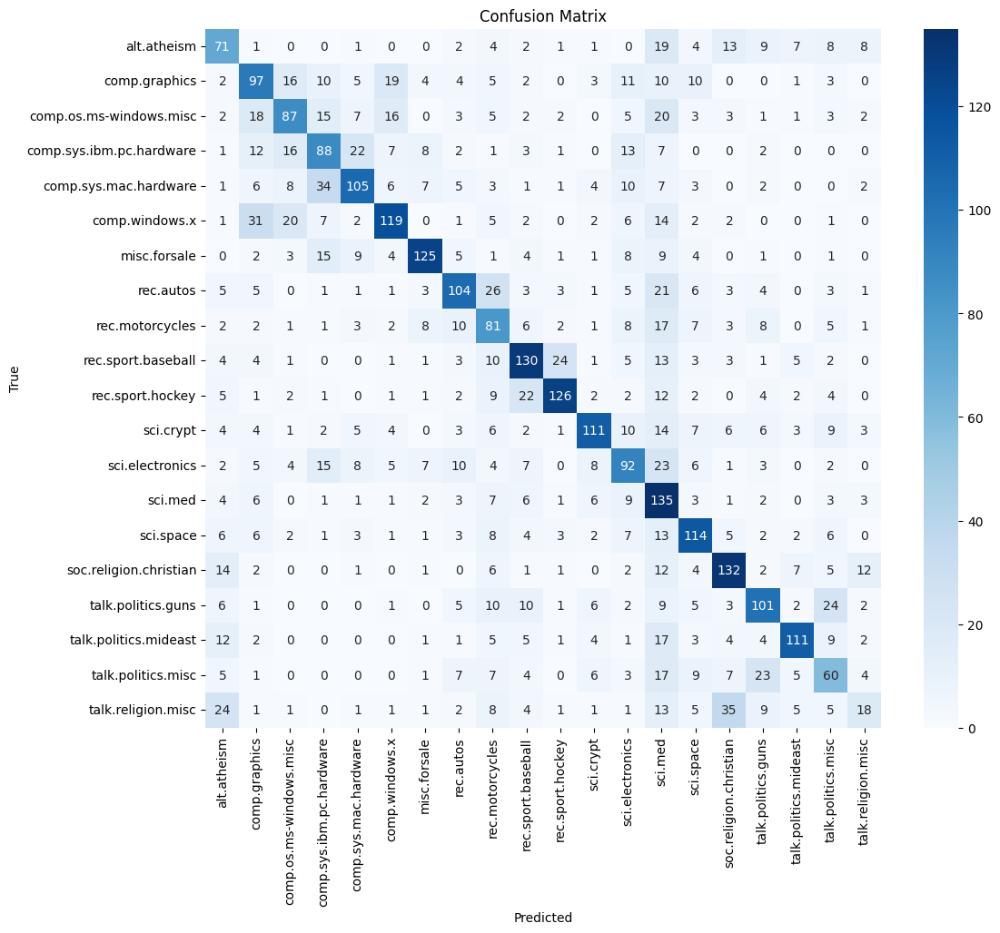

In [104]:


print("📊 Matriz de Confusão:")


cm = confusion_matrix(y_test, y_pred)
plt.figure(figsize=(12, 10))
sns.heatmap(
    cm,
    annot=True,
    fmt="d",
    cmap="Blues",
    xticklabels=newsgroups["target_names"],
    yticklabels=newsgroups["target_names"],
)
plt.xlabel("Predicted")
plt.ylabel("True")
plt.title("Confusion Matrix")
plt.show()

Ao trabalhar com uma nova entrada, será necessário aplicar o mesmo pré-processamento utilizado no treinamento, como a vetorização com TF-IDF e a redução de dimensionalidade, se aplicável. A seguir é uma breve demonstração de como isso pode ser feito:

In [105]:
# Trabalhando com novas entradas

data = """
From: gtucker@phoenix.cs.utexas.edu (Gary Tucker)
Subject: Re: VLB vs. EISA for gaming?
Organization: Dept. of Computer Science, University of Texas, Austin
Lines: 41
NNTP-Posting-Host: phoenix.cs.utexas.edu
Distribution: usa

In article <C5xyz.123@hub.uiuc.edu> bsimpson@uiuc.edu (Bart Simpson) writes:
> I'm putting together a new 486DX2/66 machine and I'm trying to decide
> on the motherboard. Everyone says VESA Local Bus (VLB) is the fastest
> for video, but EISA seems more robust for other peripherals like SCSI
> controllers. Does anyone have benchmarks for DOOM on these two bus types?

This is a classic trade-off. For pure, raw video throughput for DOS games
like DOOM, VLB is almost always going to give you a slight edge, especially
with a good Tseng ET4000/W32 or an S3 805 based card. The direct access to the
CPU's local bus is hard to beat for single-tasking environments.

However, you've hit on the main problem: VLB can be flaky. It was never a
truly robust standard and can cause weird timing issues, especially if you
populate both VLB slots.

EISA, on the other hand, is a rock-solid bus. Its main advantage isn't
raw speed for one device, but its ability to handle multiple bus-mastering
devices (like a good Adaptec SCSI card and a network card) without choking
the CPU. This is a huge win if you plan on running something like OS/2 Warp
or the upcoming Windows "Chicago" (what they're calling Win95).

My opinion? If this machine is a dedicated DOS gaming rig and nothing else,
go with a quality VLB motherboard and don't look back. If you plan to use
it for *anything* else, especially multitasking, the stability and better
architecture of EISA is worth the small performance hit in video. You won't
notice a 5% drop in framerate, but you will definitely notice when your
system locks up because the VLB controller is having a bad day.

Just my $0.02.

-- 
Gary Tucker, System Administrator
"I've seen things you people wouldn't believe. Attack ships on fire off the
 shoulder of Orion... Time to die."
gtucker@cs.utexas.edu
"""

data_cleaned = preprocessar_texto(data)
data_vectorized = vectorizer.transform([data_cleaned])
# Fazendo a predição
predicted_class = model.predict(data_vectorized)[0]
predicted_class_name = mapping[predicted_class]
print(
    f"📊 Classe prevista para o novo documento: {predicted_class} - {predicted_class_name}"
)

📊 Classe prevista para o novo documento: 3 - comp.sys.ibm.pc.hardware


In [106]:
# Salvando o modelo treinado e o vetorizer com pickle
import pickle

with open("../models/text_classification/model.pkl", "wb") as model_file:
    pickle.dump(model, model_file)
with open(
    "../models/text_classification/vectorizer.pkl", "wb"
) as vectorizer_file:
    pickle.dump(vectorizer, vectorizer_file)